# Τεχνητή Νοημοσύνη: Εργαστηριακή Άσκηση 1

### Αλεξανδρόπουλος Σταμάτης     ΑΜ:03117060


### Άγγελος Στάης                            ΑΜ:03117435

#installed latest matplotlib version
!pip install --upgrade matplotlib

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
from IPython.display import HTML

class visualization:
    def __init__(self, S, F):
        #'''
        #  Η μέθοδος αυτή αρχικοποιεί ένα αντικείμενο τύπου visualization.
        #  Είσοδος: 
        #  -> S: το σημείο εκκίνσης της αναζήτησης
        #  -> F: το σημείο τερματισμού
        #'''
        self.S = S
        self.F = F
        self.images = []
    
    def draw_step(self, grid, frontier, expanded_nodes):
        #'''
        #  Η συνάρτηση αυτή καλείται για να σχεδιαστεί ένα frame στο animation (πρακτικά έπειτα από την επέκταση κάθε κόμβου)
        #  Είσοδος: 
        #  -> grid: Ένα χάρτης τύπου grid
        #  -> frontier: Μια λίστα με τους κόμβους που ανήκουν στο μέτωπο της αναζήτησης
        #  -> expanded_nodes: Μια λίστα με τους κόμβους που έχουν ήδη επεκταθεί
        #  Επιστρέφει: None
        #  Η συνάρτηση αυτή πρέπει να καλεστεί τουλάχιστον μια φορά για να μπορέσει να σχεδιαστει ένα animation (πρεπεί το animation να έχει τουλάχιστον ένα frame).
        #'''
        image = np.zeros((grid.N, grid.N, 3), dtype=int)
        image[grid.grid == 0] = [255, 255, 255]
        image[grid.grid == 1] = [0, 0, 0]
        
        for node in expanded_nodes:
            image[node] = [0, 0, 128]

        for node in frontier:
            image[node] = [0, 225, 0]

        image[self.S] = [50, 168, 64]
        image[self.F] = [168, 50, 50]
        self.images.append(image)
    
    def add_path(self, path):
        #'''
        #  Η συνάρτηση αυτή προσθέτει στο τελευταίο frame το βέλτιστο μονοπάτι.
        #  Είσοδος:
        #  -> path: Μια λίστα η όποια περιέχει το βέλτιστο μονοπάτι (η οποία πρέπει να περιέχει και τον κόμβο αρχή και τον κόμβο στόχο)
        #  Έξοδος: None
        # '''
        for n in path[1:-1]:
            image = np.copy(self.images[-1])
            image[n] = [66, 221, 245]
            self.images.append(image)
        for _ in range (100):
            self.images.append(image)
        
    def create_gif(self, fps = 30, repeat_delay = 2000):
        if len(self.images) == 0:
            raise EmptyStackOfImages("Error! You have to call 'draw_step' at  first.")
        fig = plt.figure()
        plt.axis('off')
        ims = []
        for img in self.images:
            img = plt.imshow(img)
            ims.append([img])
        ani = animation.ArtistAnimation(fig, ims, interval=1000//fps, blit=True, repeat_delay= repeat_delay)
        plt.close(fig)
        return ani
        
    def save_gif(self, filename, fps = 30):
       # '''
       #    Η συνάρτηση αυτή ξαναδημιουργεί και αποθηκεύει το animation σε ένα αρχείο.
       #     Είσοδος:
       #     -> Το όνομα του αρχείου με κατάληξη .gif
       #     Έξοδος: (None)
       # '''
        ani = self.create_gif(fps)
        writer = PillowWriter(fps= fps)
        ani.save(filename, writer=writer)

    def show_gif(self, fps= 30, repeat_delay = 2000):
        #'''
        #    Η συνάρτηση αυτή εμφανίζει inline το animation.
        #    Είσοδος:
        #    -> fps: τα frames per second
        #    Έξοδος: Το αντικείμενο που παίζει το animation
        #    Exceptions: EmptyStackOfImages αν το animation δεν έχει ούτε ένα frame, δηλαδή αν η draw_step δεν έχει καλεστεί ποτέ.
        #'''
        ani = self.create_gif(fps, repeat_delay)
        # return HTML(ani.to_html5_video())
        return HTML(ani.to_jshtml())

    def show_last_frame(self):
        #'''
        #    Η μέθοδος αυτή εμφανίζει inline το τελευταίο frame που έχει δημιουργήθει.
        #    Είσοδος:
        #    Έξοδος: Το αντικείμενο που εμφανίζει την εικόνα.
        #    Exceptions: EmptyStackOfImages αν το animation δεν έχει ούτε ένα frame, δηλαδή αν η draw_step δεν έχει καλεστεί ποτέ.
        #'''
        if len(self.images) == 0:
            raise EmptyStackOfImages("Error! You have to call 'draw_step' at  first.")
        else:
            plt.imshow(self.images[-1])

class EmptyStackOfImages(Exception):
    pass

# Μέρος 1ο 


Στο μέρος αυτό υλοποιήσαμε τον δοθέν αλγόριθμο για την παραγωγή λαβυρίνθων. Αυτό επιτεύχθηκε μέσω της make_random_path. Συγκεκριμένα όλα τα κελιά αρχικά περιέχουν εμπόδια. Χρησιμοποιούμε τον εξής συμβολισμό:

0-> κελί που είναι μέρος του λαβυρίνθου (μονοπάτι)

1-> τοίχος

Έπειτα μέσω της make_random_path επιλέγεται αρχικά ένας τυχαίος τοίχος να γίνει μέρος του λαβυρίνθου. Όσο η λίστα των τοίχων (την οποία στο κώδικά μας την έχουμε υλοποιήσει με set και την έχουμε ονομάσει frontiers)  δεν  είναι κενή: 

    a.Επιλέγεται τυχαία ένας τοίχος από τη λίστα. Αν  μόνο ένα από τα δύο κελιά που χωρίζει ο τοίχος είναι μέρος του λαβυρίνθου, τότε:
        1.Ο τοίχος και το κελί που δεν είναι μέρος του λαβύρινθου, γίνονται μέρος του λαβύρινθου.
        2.Οι τοίχοι των νέων κελιών που προστέθηκαν στο λαβύρινθο προστίθεται στη λίστα των τοίχων.
        
    b.Στη συνέχεια αφαιρείται τοίχος από τη λίστα των τοίχων. 
    
Στην υλοποίηση της παραπάνω συνάρτησης που ακολουθεί το ψευδοκώδικα της εκφώνησης όπως φαίνεται και από την υλοποίηση (βλέπε και σχόλια διπλα απο το κώδικα στα αντίστοιχα σημεία) έγινε χρήση και των εξής 3 συναρτήσεων:

     1.neighbors2:Παίρνει σαν όρισμα ένα κελί-μέρος του λαβυρίνθου και επιστρέφει 
       όλους τους νόμιμους (εντός ορίων του πίνακα δηλαδή) γειτονικούς τοίχους.
      
      2.wall_neighboors: Παίρνει σαν όρισμα έναν τοίχο και επιστρέφει ένα set με όλες τις νόμιμες 
        (εντός ορίων του πίνακα δηλαδή) αντιστοιχήσεις των θέσεων των γείτονικών κελιών 
        που ανήκουν στο λαβύρινθο (δηλαδή μονοπατιών). 
        Συγκεκριμένα αν (x,y) το σημείο που παίρνει σαν όρισμα η wall_neighboors τότε:
        το 0 αντιστοιχεί στην θέση (x-1,y)
        το 1 αντιστοιχεί στην θέση (x+1,y)
        το 2 αντιστοιχεί στην θέση (x,y-1)
        το 3 αντιστοιχεί στην θέση (x,y+1)
        
       3.isLegal
       Επιστρέφει αν ένας κόμβος είναι νόμιμος, δηλαδή  είναι εντός του λαβυρίνθου
     
Ο λαβύρινθος που φτιάχνει αυτή η συνάρτηση  έχει την ιδιότητα οποιοιδήποτε δύο κόμβοι εντός του λαβυρίνθου έχουν μονοπάτι μεταξύ τους. Αυτο γίνεται για τον εξής λόγο: Με βάση τον παραπάνω αλγόριθμο σε κάθε τυχαία επιλογή τοίχου (έστω (x,y) ο τοίχος που επιλέγεται) ο ένας γείτονας  του τοίχου (έστω π.χ. ο (x,y-1)) είναι ήδη μέρος του λαβυρίνθου και ο συμμετρικός γείτονας ως προς τον τοίχο είναι τοίχος (δηλαδή ο (x,y+1)  είναι τοίχος) , εφόσον πάντα αν μόνο ένα από τα δύο κελιά που χωρίζει ο τοίχος είναι μέρος του λαβυρίνθου (αντίστοιχα λογική θα ακολουθούσαμε αν επιλέγαμε το (x-1,y) ή το (x+1,y)). Έπειτα γίνονται τόσο ο τοίχος όσο και ο συμμετρικός γείτονας μέρη του λαβυρίνθου. Άρα κάθε φορά, κάθε νέο κελί που προστίθεται στο λαβύρινθο είναι γειτονικό με ήδη υπάρχον μέρος του λαβυρίνθου. Άρα πάντα θα υπάρχει μονοπάτι ανάμεσα σε δύο κόμβους του λαβυρίνθου.

Όμως ο αλγόριθμος δεν εγγυάται πάντα ότι το σημείο εκκίνησης S και το σημείο τερματισμού F θα ανήκουν στο λαβύρινθο (παρόλο που στην αρχή του δοθέντος κώδικα έχουν αρχικοποιηθεί ως κελιά) και άρα δεν εξασφαλίζει πάντα την ύπαρξη μονοπατιού από το S στο F. 
To πρόβλημα της μη ύπαρξης μονοπατιού συμβαίνει μόνο όταν είτε το S είτε το F, είτε και οι 2 κόμβοι περιβάλλονται από 4 τοίχους. 
Για να επιλύσουμε το πρόβλημα καλούμε για το ένα την node_alone. Αυτή αρχικά καλεί τη neighbors  η οποία επιστρέφει πόσους γείτονες  (εντός των ορίων του πίνακα, το οποίο γίνεται με την isLegal) έχει ο κόμβος και πόσοι από αυτούς είναι τοίχοι. Έπειτα στην neighbors αν ο κόμβος για το οποίον ενδιαφερόμαστε περιβάλλεται από 4 επιτρεπτούς (εντός ορίων του πίνακα) τοίχους τότε σημαίνει ότι πρέπει να ενώσουμε το σημείο αυτό  με τον υπόλοιπο λαβύρινθο. Για να το επιτύχουμε αυτό δημιουργούμε μια λίστα temp_set στην οποία προσθέτουμε αρχικά τους 4 τοίχους από τους οποίους περιβάλλεται ο κόμβος. Έπειτα επιλέγουμε τυχαία έναν τοίχο από τη λίστα, τον κάνουμε μέρος του λαβυρίνθου και έπειτα βρίσκουμε τους γέιτονες αυτού του νεόυ κόμβου. Συνεχίζουμε να επαναλαμβάνουμε την ίδια διαδικασία μόνο αν ο νέος κόμβος έχει 3 γείτονες-τοίχους (αφού ο ένας είναι ο κόμβος από τον οποίο προήλθαμε, ο οποίος είναι και μέρος πλέον του λαβυρίνθου). Μόλις δημιουργώντας το μονοπάτι από το αρχικό σημείο για το οποίο καλέσαμε την neighbors (εδώ S η F) φτάσουμε σε κόμβο που έχει λιγοτερους από 3 γείτονες-τοίχους τότε σημαίνει ότι έχει δημιουργηθεί μονοπάτι μεταξυ του S ή F με τον υπόλοιπο λαβύρινθο (ο οποίος όπως εξηγήσαμε παραπάνω εγγυάται πάντα την ύπαρξη μονοπατιού μεταξύ δύο οποιονδήποτε κελίων του). Έτσι εγγυόμαστε ότι πάντα θα υπάρχει μονοπάτι μεταξύ του  S και του F. Τα παραπάνω φαίνονται αναλυτικότερα στο παρακάτω κώδικα. Επισημαίνεται ότι ο make_random_path έχει υλοποιηθεί με δύο τρόπους που δίνουν ίδιο αποτέλεσμα.


In [2]:
# ΚΩΔΙΚΑΣ 1ΟΥ ΜΕΡΟΥ
%matplotlib inline
import numpy as np
from queue import LifoQueue
from random import shuffle, uniform
import matplotlib.pyplot as plt
import random
import math 

class grid:
    def __init__(self, N, S, F):
        # N: διάσταση λαβυρίνθου, S: αρχή, F: τέλος
        
        ## Make sure start and end are within the grid
        assert N > 2
        assert S[0] < N
        assert S[1] < N
        assert F[0] < N
        assert F[1] < N

        assert S[0] > 0
        assert S[1] > 0
        assert F[0] > 0
        assert F[1] > 0

        self.N = N

        ## Initialize grid with obstacles
        self.grid = np.ones((N, N), dtype=np.int32)
        # Επιστρέφεται ένας πίνακας Ν*Ν με 1 που θεωρούνται εμπόδια

        #Θέτουμε την Αρχή και το Τέλος μονοπάτι (ελεύθερους κόμβους)
        self.grid[S]=0
        self.grid[F]=0
        obstacle_free_points = {S, F}

        # Τοίχος -->1 
        # Μονοπάτι (Μέρος Λαβυρίνθου) -->0
        
    def isLegal(self,node): # Νόμιμος Κόμβος-Εντός του λαβυρίνθου
        return node[0]>=0 and node[0]<N and node[1]>=0 and node[1]<N

    def neighbors(self,node):
        legal_count=0
        count=0
        for n in (node[0]-1,node[1]),(node[0]+1,node[1]),(node[0],node[1]-1),(node[0],node[1]+1): 
            if (self.isLegal(n)): 
                legal_count=legal_count+1
                if (self.grid[n]==1):
                    count=count+1
        return (legal_count,count)
    
    def node_alone(self,node):
        l=self.neighbors(node)
        if(l[0]==l[1]): 
            # Αν έχουμε 4 κόμβοι επιτρεπτούς και 4 τοίχους
            # πρέπει να συνδέσουμε το κόμβο(Start ή Finish) με τον υπόλοιπο λαβύρινθο
            temp_set=[] # σύνολο νόμιμων κόμβων
            if (self.isLegal((node[0]+1,node[1]))):
                temp_set.append((node[0]+1,node[1]))
            if (self.isLegal((node[0]-1,node[1]))):
                temp_set.append((node[0]-1,node[1]))
            if (self.isLegal((node[0],node[1]+1))):
                temp_set.append((node[0],node[1]+1))
            if (self.isLegal((node[0],node[1]-1))):
                temp_set.append((node[0],node[1]-1))
        
            new_node=random.choice(temp_set)
            temp_set.remove(new_node)
            self.grid[new_node]=0
            l=self.neighbors(new_node)
            past_node=node
            while(l[0]==l[1]+1):
                if (self.isLegal((new_node[0]+1,new_node[1])) and (new_node[0]+1,new_node[1])!=past_node):
                    temp_set.append((new_node[0]+1,new_node[1]))
                if (self.isLegal((new_node[0]-1,new_node[1])) and (new_node[0]-1,new_node[1])!=past_node):
                    temp_set.append((new_node[0]-1,new_node[1]))
                if (self.isLegal((new_node[0],new_node[1]+1)) and (new_node[0],new_node[1]+1)!=past_node):
                    temp_set.append((new_node[0],new_node[1]+1))
                if (self.isLegal((new_node[0],new_node[1]-1)) and (new_node[0],new_node[1]-1)!=past_node):
                    temp_set.append((new_node[0],new_node[1]-1))
                past_node=new_node
                new_node=random.choice(temp_set)
                temp_set.remove(new_node)
                self.grid[new_node]=0
                l=self.neighbors(new_node)
            
    #Αυτή η συνάρτηση παίρνει σαν όρισμα ένα κελί-μέρος του λαβυρίνθου και επιστρέφει ένα 
    #set με όλους τους νόμιμους(εντός ορίων του πίνακα δηλαδή) γείτονικούς τοίχους
    def neighbors2(self,node): 
        adj=set()
        for n in (node[0]-1,node[1]),(node[0]+1,node[1]),(node[0],node[1]-1),(node[0],node[1]+1): 
            if (self.isLegal(n)): 
                if (self.grid[n]==1):
                    adj.add(n)
        return adj 

    #Αυτή η συνάρτηση παίρνει σαν όρισμα έναν τοίχο και επιστρέφει ένα 
    #set με όλους τις νόμιμες(εντός ορίων του πίνακα δηλαδή) αντιστοιχήσεις των θέσεων των γείτονικών κελιών-που είναι μέρη του λαβυρίνθου
    #Συγκεκριμένα αν (x,y) το σημείο που παίνρει σαν όρισμα η wall_neighboors 
    #το 0 αντιστοιχεί στην θέση (x-1,y)
    #το 1 αντιστοιχεί στην θέση (x+1,y)
    #το 2 αντιστοιχεί στην θέση (x,y-1)
    #το 3 αντιστοιχεί στην θέση (x,y+1)
    def wall_neighboors(self,node):   
        adj=set()
        i=0 #for the enumeration
        for n in (node[0]-1,node[1]),(node[0]+1,node[1]),(node[0],node[1]-1),(node[0],node[1]+1): 
            if (self.isLegal(n)): 
                if (self.grid[n]==0):
                    adj.add(i)
            i=i+1
        return adj 
    
    #αλγόριθμος παραγωγής λαβυρίνθων
    def make_random_path(self,start,end):
        frontiers=set() #λιστα των τοιχων
        list1=range(0,N)
        list2=range(0,N)
        x_wall=np.random.choice(list1) 
        y_wall=np.random.choice(list2)
        self.grid[(x_wall,y_wall)]=0
        frontiers=self.neighbors2((x_wall,y_wall)) 
        while(len(frontiers)!=0):
            removed=random.sample(frontiers,1)[0] #Επιλέγεται τυχαία ένας τοίχος από τη λίστα
            wall_neghb_set=set()
            x=removed[0]
            y=removed[1]
            wall_neghb_set=self.wall_neighboors(removed)
            if(len(wall_neghb_set)!=4): #αν υπαρχει τουαλχιστον ενας τοιχος γειτονας
                if(len(wall_neghb_set)==1): #Εαν μόνο ένα από τα (δύο) κελιά που χωρίζει ο τοίχος είναι μέρος του λαβυρίνθου, τότε:
                    #Ανάλογα πλέον με τη περίπτωση έχουμε βρεί με ποιο κελί-μέρος του λαβυρίνθου συνορεύει ο τοίχος και
                    #και παίρνουμε το αντιδιαμετρικό του- τοίχο (το οποίο εξασφαλίστηκε απο την wall_neighboors) και αν ειναι νόμικο 
                    #το κάνουμε τόσο αυτό όσο και το τοίχο κελία -μέρη του λαβυρίνθου
                    if(0 in wall_neghb_set): 
                        check=(x+1,y)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0 #Ο τοίχος και το κελί που δεν είναι μέρος του λαβυρίνθου, γίνονται μέρος του λαβυρίνθου.
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            #Οι τοίχοι των νέων κελιών που προστέθηκαν στο λαβύρινθο προστίθενται στη λίστα των τοίχων
                            frontiers.update(one)
                            frontiers.update(two)
                    elif(1 in wall_neghb_set):
                        check=(x-1,y)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            frontiers.update(one)
                            frontiers.update(two)
                    elif(2 in wall_neghb_set):
                        check=(x,y+1)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            frontiers.update(one)
                            frontiers.update(two)
                    elif(3 in wall_neghb_set):
                        check=(x,y-1)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            frontiers.update(one)
                            frontiers.update(two)

            frontiers.remove(removed) #Ο τοίχος αφαιρείται από τη λίστα των τοίχων
        self.node_alone(start)
        self.node_alone(end)
        
#     Εναλλακτική Υλοποίηση:       
#     def make_random_path(self,start,end):
#         frontiers=set()
#         list1=range(0,N)
#         list2=range(0,N)
#         x_wall=np.random.choice(list1) 
#         y_wall=np.random.choice(list2)
#         # Βήμα 2: Διαλέγουμε τυχαίο ένα κελί να γίνει μέρος του λαβύρινθου
        
#         #x_wall=start[0]
#         #y_wall=start[1]
        
#         frontiers.add((x_wall,y_wall,x_wall,y_wall))
#         while(len(frontiers)!=0):
#             removed=random.sample(frontiers,1)[0] #element removed
#             frontiers.remove(removed)
#             x=removed[2]
#             y=removed[3]
#             if(self.grid[(x,y)]==1):
#                 self.grid[(removed[0],removed[1])]=0
#                 self.grid[(x,y)]=0
#                 if((x>2) and self.grid[(x-2,y)]==1):
#                     frontiers.add((x-1,y,x-2,y))
#                 if(y>2 and self.grid[(x,y-2)]==1):
#                     frontiers.add((x,y-1,x,y-2))
#                 if(x<N-3 and self.grid[(x+2,y)]==1):
#                     frontiers.add((x+1,y,x+2,y))
#                 if(y<N-3 and self.grid[(x,y+2)]==1):
#                     frontiers.add((x,y+1,x,y+2))
        
#         self.node_alone(start)
#         self.node_alone(end)

# Τέλος Δικού μας Κώδικα

    def draw_map(self, S=None, F=None, path=None):
        image = np.zeros((self.N, self.N, 3), dtype=int)
        image[self.grid == 0] = [255, 255, 255]
        image[self.grid == 1] = [0, 0, 0]
        if S:
            image[S] = [50, 168, 64]
        if F:
            image[F] = [168, 50, 50]
        if path:
            for n in path[1:-1]:
                image[n] = [66, 221, 245]

        plt.imshow(image)
        plt.xticks([])
        plt.yticks([])
        plt.show()

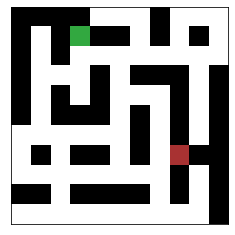

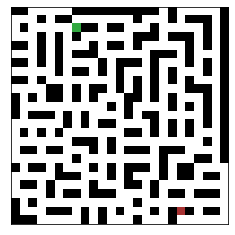

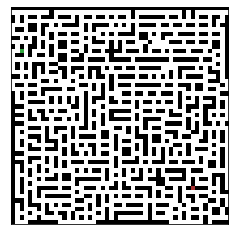

In [3]:
# Παράδειγμα Εκτύπωσης Λαβυρίνθων 1ου Ερωτήματος
for N, S, F in (11, (1, 3), (7, 8)), (25, (2, 7), (23, 19)), (51, (10, 2), (42, 42)):
    map = grid(N, S, F)
    map.make_random_path(S,F)
    map.draw_map(S, F)

# Μέρος 2

Στο μέρος αυτό κατασκευάσαμε διάφορους αλγόριθμους αναζήτησης για την εύρεση μονοπατιών μεταξύ δύο κόμβων και τους εφαρμόσαμε στους λαβυρίνθους που κατασκευάσαμε στο 1ο Μέρος. Για την εφαρμογή των αλγορίθμων κατασκευάσαμε διάφορες συναρτήσεις κόστους τόσο για την μέτρηση του πραγματικού όσο και για την εκτίμηση των αποστάσεων από έναν κόμβο στον κόμβο στόχο (heuristic). Ο στόχος της ευριστικής συνάρτησης είναι να δίνει τις κατάλληλες και όσο το δυνατόν πιο ακριβείς πληροφορίες για την αποτελεσματικότερη ανίχνευση της διαδρομής. Για την επιλογή κατάλληλης ευριστικής, εξετάζονται δύο κριτήρια:

        1.Μια ευριστική πρέπει να είναι παραδεκτή , πράγμα που σημαίνει ότι ποτέ δεν θα υπερεκτιμά την απόσταση, αφού σε 
        διαφορετική περίπτωση ο αλγόριθμος δεν θα δουλέψει σωστά και μπορεί να επιστρέψει διαδρομές που δεν είναι βέλτιστες.
        2.Μια ευριστική πρέπει να επιστρέψει τη μεγαλύτερη δυνατή απόσταση. Μια ευριστική που υποτιμά την εναπομένουσα διαδρομή από ένα κελί, θα ευνοήσει αυτό το κελί όταν ένα άλλο θα μπορούσε να ήταν καλύτερο.

###### Φυσικά η ιδανική ευριστική συνάρτηση θα επέστρεφε το ακριβές μήκος (το οποίο γενικά δεν είναι εφικτό επειδή δεν μπορεί να επιστρέψει ένα μακρύτερο μονοπάτι χωρίς να σταματήσει να είναι παραδεκτό). Για αυτό γίνεται ένας συμβιβασμός μεταξύ αυτών των δύο με τις ευριστικές συναρτήσεις που υλοποιούνται να είναι η manhattan_distance, η euclidean_distance και η chebyshev_distance την οποία την προσθέσαμε εμείς.

Οι αλγόριθμοι αναζήτησης που υλοποιήσαμε στηρίζονται στον αλγόριθμο A* , η γενική μορφή συνάρτησης κόστους του οποίου είναι:
$$ 𝑓(𝑛)=𝑔(𝑛)+ℎ(𝑛) $$
όπου g(n): πραγματική απόσταση από το σημείο έναρξης μέχρι τον κόμβο n και 
     h(n): ευριστική εκτίμηση της απόστασης από τον κόμβο n μέχρι τον στόχο.
Η συνάρτηση που υλοποιεί την γενική μορφή των αλγορίθμων αναζήτησης (που στηρίζονται στον A*)  είναι η find_path. Ο ψευδοκώδικας της είναι ο εξής:

•	Αρχικοποιούμε μια (κενή αρχικά) open_list (που περιλαμβάνει του κόμβους που δεν έχουμε επισκεφτεί ακόμα) και (μια κενή αρχικά) closed_list (που περιλαμβάνει τους κόμβους που έχουμε επισκεφτεί), τις οποίες υλοποιήσαμε με sets.  

•	Τοποθετούμε στην open_list το σημείο έναρξης S 
•	Αρχικοποιούμε το πραγματικό της κόστος ίσο με μηδέν και ορίζουμε ένα dictionary parent_dict που περιλαμβάνει τον γονέα για το κάθε κόμβο  που θα επισκεφτούμε.
•	Όσο η open_list δεν είναι κενή επαναλαμβάνεται:

    1. Ορίζουμε ως current_node το κόμβο από αυτούς της open_list που έχει τη μικρότερη f=g+h . 
        Το κόμβο αυτόν τον αφαιρούμε από την open_list και τον προσθέτουμε στην closed_list.
    2. Αν ο current_node== F 
        a. Κάνουμε backtract στον parent_dict για να βρούμε το μονοπάτι από τον S στον F.
        b. Επιστρέφουμε το μονοπάτι
    3. Βρίσκουμε τους γείτονες του current_node
    4. Για κάθε γείτονα n επανάλαμβάνουμε:
        a. Αν ο n δεν είναι στην open_list και δεν είναι στην closed_list
            i. Τον προσθέτουμε στην open_list
            ii. Ορίζουμε ως πατέρα του n τον current_node
            iii. Το πραγματικό κόστος g[n]=g[current_node]+1 
        b.	Διαφορετικά:
            i. Αν o n ανήκει στην open_list
                1. Αν το πραγματικό κόστος του n είναι υψηλότερο  από το g[current_node]+1 
                    a. Θέτουμε g[n]=g[current_node]+1 και ορίζουμε ώς πατέρα του n το current node
                    

To βήμα 4 όπως φαίνεται και στο κώδικα έχει υλοποιηθεί με 2 τρόπους αλλά η γενική ιδέα είναι η ίδια.
Όλα αυτά φαίνονται στη συνάρτηση  find_path, της οποίας η εκτέλεση κάθε φορά τροποποιείται ανάλογα με τις τιμές των παραμέτρων με τις οποίες καλείται (και συκγεκριμένα lambda x, y: y ή lambda x, y: x ή lambda x, y: x+y)  και την ευριστική που επιλέγουμε κάθε φορά. Συγκεκριμένα βλέπουμε ότι:

        •	Αν g(n)=0 και h(n)= { manhattan(n), euclidean(n) }, ο αλγόριθμος αναζήτησης είναι ο Best First, ο οποίος χρησιμοποιεί μόνο μία ευριστική συνάρτηση της απόστασης και καμιά συνάρτηση πραγματικού κόστους (γιαυτό και δέχεται σαν όρισμα το lambda x, y: y στη θέση του cost). Το μονοπάτι που δίνει ως αποτέλεσμα δεν είναι πάντα το βέλτιστο μονοπάτι.
        •	Αν g(n)=1 και h(n)=0,ο αλγόριθμος αναζήτησης είναι ο Dijkstra, ο οποίος χρησιμοποιεί μόνο μια συνάρτηση πραγματικής απόστασης από το σημείο εκκίνησης μέχρι τον κόμβο n, g(n), και όχι κάποια ευριστική γι' αυτό και δέχεται σαν όρισμα το lambda x, y: x στη θέση του cost). To μονοπάτι που προκύπτει είναι πάντα το βέλτιστο μονοπάτι.
        •	Αν g(n)=1 και h(n)={manhattan(n),euclidean(n)} ,ο αλγόριθμος αναζήτησης είναι ο Α*, ο οποίος χρησιμοποιεί μια ευριστική συνάρτηση της απόστασης h(n) και μια συνάρτηση πραγματικής απόστασης g(n),δηλαδή το f(n)= g(n)+h(n) (γιαυτό και δέχεται σαν όρισμα το lambda x, y: x+y στη θέση του cost). To μονοπάτι που προκύπτει είναι πάντα το βέλτιστο μονοπάτι οταν η ευριστική συνάρτηση είναι αποδεκτή( admissible) (όπως εδώ) .

Έτσι ανάλογα με τις συναρτήσεις πραγματικής και ευριστικής συνάρτησης με την οποία καλείται η find_path, λειτουργεί σαν Best_First, Dijkstra η Α* αντίστοιχα όπως φαίνεται παρακάτω.

In [4]:
# ΚΩΔΙΚΑΣ 2ΟΥ ΜΕΡΟΥΣ
#from visualization import *

class pathfinder:
    def __init__(self, S, F, grid, c, h):
        self.S = S
        self.F = F
        self.grid = grid
        self.cost = c
        self.heuristic = h
        #for visualization
        self.vis = visualization(S, F)
        self.path=[]
        self.expanded_nodes=[] #for the visualization


    def find_path(self,part3=False):
        #open_list is a set with the nodes whose neighbours haven't been inspected yet
        open_list = set([S])
        #closed_list is a set with all the nodes whose neighbours have been inspected
        #These are the expanded nodes
        closed_list = set([])
        #g(n) is the real cost for node n
        g={} # πραγματική απόσταση που έχουμε διανύσει
        g[S]=0
        parent_dict = {}
        parent_dict[S] = S
        #Loop until you find the end
        while len(open_list) > 0:
            #in order to make the visualization:
            if(part3):
                frontier=list(open_list)
                expanded_nodes=list(closed_list)
                self.vis.draw_step(self.grid, frontier, expanded_nodes)

            current_node = None
            #check nodes that haven't been inspected yet, find the one with the minimum cost and save it as current_node
            for v in open_list: # βρίσκει μόνο το μικρότερο
               #c-> lambda x,y 
               #h->lambda
                if current_node == None or self.cost(g[v],self.heuristic(v,F)) < self.cost(g[current_node] ,self.heuristic(current_node,F)):
                    current_node = v; # το κ΄΄ανει current node
            open_list.remove(current_node)
            closed_list.add(current_node)
            #if current_node is the final node F follow the path that led us here by finding the parent of each node.
            if current_node == F: #αν είναι ίσο με το τελικό
                path = []
                while parent_dict[current_node] != current_node:
                    path.append(current_node)
                    current_node = parent_dict[current_node]
                path.append(S)
                path.reverse()
                self.path=path
                self.expanded_nodes=closed_list
                if(part3):
                    self.vis.add_path(path)
                return path
            #if current_node is not the final node, we need to check its adjacent nodes that are not in either the closed or the open list
            #and add them in the open list, while saving their parent node(current_node) and their cost.
            adjacent_nodes = []
            for n in (current_node[0] - 1, current_node[1]), (current_node[0] + 1, current_node[1]), (current_node[0], current_node[1] - 1), (current_node[0], current_node[1] + 1):
                if self.grid.isLegal(n):
                    if self.grid.grid[n] == 0 :
                        adjacent_nodes.append(n)
            #α τρόπος 
            for n in adjacent_nodes:                 
                if n not in open_list and n not in closed_list:
                    open_list.add(n)
                    parent_dict[n] = current_node
                    g[n] = g[current_node] + 1
               #if an adjacent node is in the open or the closed list, we need to check if it has cost is bigger than g[current_node]+1
                else:
                    if n in open_list:
                        if g[n] > g[current_node] + 1:
                            g[n] = g[current_node] + 1
                            parent_dict[n] = current_node
                        #we've found a better cost for node n.
            #β τρόπος 
#             for n in adjacent_nodes:
#                 if n in closed_list:
#                     continue
#                 g[n] = g[current_node] + 1
#                 if n in open_list:
#                     if g[n]<g[current_node]+1:
#                         continue
#                 open_list.add(n)
#                 parent_dict[n] = current_node 

    def get_path(self):
        return self.path

    #returns the expaned nodes
    def get_expanded_nodes(self):
        return self.expanded_nodes

In [5]:
N = 100
S = (5, 9)
F = (95, 85)

#Heuristics:
def chebyshev_distance(S,F):
    return(max(abs(S[0]-F[0]), abs(S[1]-F[1])))

def manhattan_distance(S,F):
    return(abs(S[0]-F[0])+ abs(S[1]-F[1]))

def euclidean_distance(S,F):
    return np.sqrt(pow(S[0]-F[0],2) + pow(S[1]-F[1],2))

###Δημιουργία χάρτη:
map = grid(N, S, F)
map.make_random_path(S,F)

When Heuristic is manhattan_distance
Best First's path  has length  179


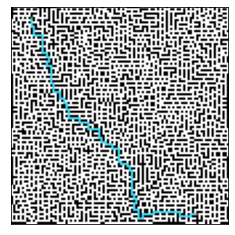

When Heuristic is manhattan_distance
Dijkstra's path has length  167


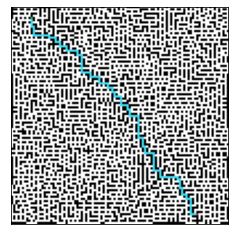

When Heuristic is manhattan_distance
A*'s path has  length  167


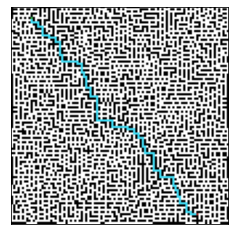

In [6]:
#manhattan_distance

#Για τον αλγόριθμο Βest First:
pf = pathfinder(S, F, map, lambda x, y: y, lambda x, y:manhattan_distance(x,y))
pf.find_path()
print("When Heuristic is manhattan_distance")
print("Best First's path  has length ",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

#Για τον αλγόριθμο Dijkstra:
pf = pathfinder(S, F, map, lambda x, y: x ,lambda x, y:manhattan_distance(x,y))
pf.find_path()
print("When Heuristic is manhattan_distance")
print("Dijkstra's path has length ",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

#Για τον αλγόριθμο A*
pf = pathfinder(S, F, map, lambda x, y: x+y, lambda x, y:manhattan_distance(x,y))
pf.find_path()
print("When Heuristic is manhattan_distance")
print("A*'s path has  length ",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

When Heuristic is euclidean_distance
Best First's path  has length  179


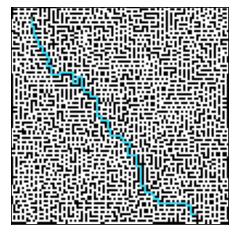

When Heuristic is euclidean_distance
Dijkstra's path has length  167


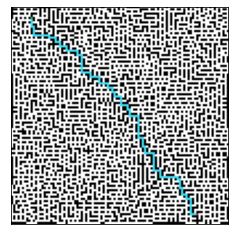

When Heuristic is euclidean_distance
A*'s path has length 167


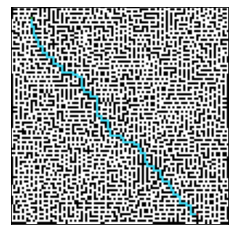

In [7]:
#euclidean_distance
#Για τον αλγόριθμο Βest First:
pf = pathfinder(S, F, map, lambda x, y: y, lambda x, y:euclidean_distance(x,y))
pf.find_path()
print("When Heuristic is euclidean_distance")
print("Best First's path  has length ",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

#Για τον αλγόριθμο Dijkstra:
pf = pathfinder(S, F, map, lambda x, y: x ,lambda x, y:euclidean_distance(x,y))
pf.find_path()
print("When Heuristic is euclidean_distance")
print("Dijkstra's path has length ",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

#Για τον αλγόριθμο A*
pf = pathfinder(S, F, map, lambda x, y: x+y, lambda x, y:euclidean_distance(x,y))
pf.find_path()
print("When Heuristic is euclidean_distance")
print("A*'s path has length",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

When Heuristic is chebyshev_distance
Best First's path  has length  191


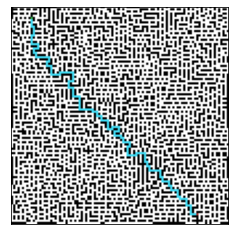

When Heuristic is chebyshev_distance
Dijkstra's path has length  167


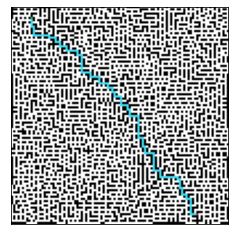

When Heuristic is chebyshev_distance
A*'s path has length 167


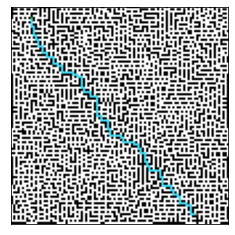

In [8]:
#chebyshev_distance
#Για τον αλγόριθμο Βest First:
pf = pathfinder(S, F, map, lambda x, y: y, lambda x, y:chebyshev_distance(x,y))
pf.find_path()
print("When Heuristic is chebyshev_distance")
print("Best First's path  has length ",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

#Για τον αλγόριθμο Dijkstra:
pf = pathfinder(S, F, map, lambda x, y: x ,lambda x, y:chebyshev_distance(x,y))
pf.find_path()
print("When Heuristic is chebyshev_distance")
print("Dijkstra's path has length ",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())

#Για τον αλγόριθμο A*
pf = pathfinder(S, F, map, lambda x, y: x+y, lambda x, y:chebyshev_distance(x,y))
pf.find_path()
print("When Heuristic is chebyshev_distance")
print("A*'s path has length",len(pf.get_path()))
map.draw_map(S,F,pf.get_path())


# Σχολιασμός για τα μήκη των μονοπατιών	

Όπως βλέπουμε παραπάνω από τις γραφικές παραστάσεις ο A* και ο Dijkstra βρίσκουν το βέλτιστο μήκος μονοπατιού (και άρα ίδιο μήκος)  ενώ ο Best First δεν βρίσκει το βέλτιστο μονοπάτι, αλλά ένα μονοπάτι που έχει μεγαλύτερο μήκος. Μάλιστα παρατηρούμε ότι για τον ίδιο λαβύριθνο το μήκος του μονοπατιού είναι το ίδιο για το Dijkstra και τον Α*, ανεξάρτητως ευριστικής,  αφού αυτοί βρίσκουν το βέλτιστο μονοπάτι. (Άλλωστε ο Dijkstra προφανως θα εβγαζε το ίδιο μονοπατι αφού δεν εξαρτάται από το ποία είναι η ευριστική (h(n)=0) αλλά μονο από το πραγματικό κόστος). Ο Best First (που επισκέπτεται την επόμενη κατάσταση με βάση την ευριστική  συνάρτηση  f (n) = h(n) με τη χαμηλότερη ευριστική τιμή)  έχει μικρότερο μήκος μονοπατιού για την euclidean, αμέσως μεγαλύτερο για την manhattan, ενώ το μεγαλύτερο είναι για την chebyshev.

Τα αποτελέσματα αυτά είναι λογικά για τους λόγους που θα φανούν στη συνέχεια. Συγκεκριμένα ο Dijkstra είναι μια ειδική περίπτωση του A* (όταν η ευριστική είναι μηδέν). Ο Dijkstra έχει μια συνάρτηση κόστους, η οποία είναι η τιμή πραγματικού κόστους από την πηγή σε κάθε κόμβο: f(n) = g(n) Βρίσκει τη συντομότερη διαδρομή από την πηγή σε κάθε άλλο κόμβο λαμβάνοντας υπόψη μόνο το πραγματικό κόστος. O Dijkstra έχει πολυπλοκοτητα O(ElogV) όπου E είναι ο συνολικός αριθμός των ακμών και V ο αριθμός των κελιών. Ο A * είναι ακριβώς όπως το Dijkstra , με τη μόνη διαφορά ότι ο A * προσπαθεί να αναζητήσει καλύτερο μονοπάτι χρησιμοποιώντας μια ευριστική συνάρτηση που δίνει προτεραιότητα σε κόμβους που υποτίθεται ότι είναι καλύτεροι από άλλους, ενώ η Dijkstra εξερευνά όλες τις πιθανές διαδρομές μέχρι να φτάσει στο στόχο. Ο Α* είναι και πλήρης (βρίσκει μονοπάτι αν υπάρχει) και βέλτιστος (βρίσκει πάντα το συντομότερο μονοπάτι) αν χρησιμοποιήσουμε μια αποδεκτή ευριστική συνάρτηση. Γενικά ο Α* είναι πιο γρήγορος από το Dijkstra (πράγμα το οποίο φαίνεται και από το Visualization παρακάτω) , ακόμη και αν απαιτεί περισσότερη μνήμη και περισσότερες λειτουργίες ανά κόμβο, καθώς εξερευνά πολύ λιγότερους κόμβους. Ο A* εκτελείται στη χειρότερη περίπτωση σε πολυωνυμικό χρόνο (σε σχέση με τον αριθμό των μεταβάσεων του βέλτιστου μονοπατιού), αν |h(x) − h * (x)| = O(log(h * (x))) όπου h*(x) η βέλτιστη ευριστική, δηλαδή η πραγματική απόσταση από το στόχο.

Αντιθέτως ο Best First επισκέπτεται την επόμενη κατάσταση με βάση την ευριστική  συνάρτηση  f (n) = h(n)  με τη χαμηλότερη ευριστική τιμή.  Δεν λαμβάνει υπόψη το κόστος της διαδρομής προς τη συγκεκριμένη κατάσταση. Το μόνο που αξιολογεί είναι ποια επόμενη κατάσταση από την τρέχουσα έχει τη χαμηλότερη ευριστική. Έτσι ο Best First είναι ένας άπληστος αλγόριθμος καθώς θα μπορούσε να επιλέξει σαν επόμενη,  κατάσταση με χαμηλότερη ευριστική αλλά με υψηλότερο συνολικό κόστος καθώς δεν λαμβάνει υπόψην του το κόστος της άφιξης από την αρχική κατάσταση σε μια επόμενη.Έχει πολυπλοκότητα Ο(n logn) , όπου n το πλήθος των κόμβων.

# Visualization.

Επειτα τροποποιήσαμε το κομμάτι κώδικα του 2ου μέρους (στα σημεία του κώδικα που αναγράφεται παραπάνω) εισάγωντας ένα επιπλέον πεδίο με όνομα  expanded_nodes  και λίγες γραμμές κώδικα όπου αξιοποιούμε το vis.draw_step που μας δίνεται .Αυτά  τα χρειαζόμαστε για την visualization  των παραπάνω αλγορίθμων.  Ανάλογα, λοιπόν, με τις τιμές των συναρτήσεων 𝑔(𝑛),ℎ(𝑛), βλέπουμε  πως επεκτείνεται το μέτωπο αναζήτησης, τα expanded nodes, και τέλος βλέπουμε το μονοπάτι που επιλέγεται. Η τελική εικόνα του Visualization σίγουρα μας δίνει μια εικόνα για την πολυπλοκότητα των αλγορίθμων σχετικά με τις  παραπάνω παραμέτρους, όμως δεν είναι τόσο ακριβής όσο η εικόνα που παίρνουμε από τις γραφικές παραστάσεις.

In [9]:
#Visualization
N= 40
S = (1, 2)
F = (38, 34)
p = 0
map = grid(N, S, F)
map.make_random_path(S,F)

# Manhattan_distance Visualization

In [10]:
print("Best First algorithm Visualization for manhattan_distance")
pf = pathfinder(S, F, map, lambda x, y: y, lambda x, y:manhattan_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

Best First algorithm Visualization for manhattan_distance


In [11]:
print("Dijkstra algorithm Visualization for manhattan_distance")
pf = pathfinder(S, F, map, lambda x, y: x, lambda x, y:manhattan_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

Dijkstra algorithm Visualization for manhattan_distance


In [12]:
print("A* algorithm Visualization for manhattan_distance")
pf = pathfinder(S, F, map, lambda x, y: x+y, lambda x, y:manhattan_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

A* algorithm Visualization for manhattan_distance


# Euclidean_distance Visualization

In [13]:
print("Best First algorithm Visualization for euclidean_distance")
pf = pathfinder(S, F, map, lambda x, y: y, lambda x, y:euclidean_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()


Best First algorithm Visualization for euclidean_distance


In [14]:
print("Dijkstra algorithm Visualization for euclidean_distance")
pf = pathfinder(S, F, map, lambda x, y: x, lambda x, y:euclidean_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

Dijkstra algorithm Visualization for euclidean_distance


In [15]:
print("A* algorithm Visualization for euclidean_distance")
pf = pathfinder(S, F, map, lambda x, y: x+y, lambda x, y:euclidean_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

A* algorithm Visualization for euclidean_distance


# Chebyshev_distance Visualization

In [16]:
print("Best First algorithm Visualization for chebyshev_distance")
pf = pathfinder(S, F, map, lambda x, y: y, lambda x, y:chebyshev_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

Best First algorithm Visualization for chebyshev_distance


In [17]:
print("Dijkstra algorithm Visualization for chebyshev_distance")
pf = pathfinder(S, F, map, lambda x, y: x, lambda x, y:chebyshev_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

Dijkstra algorithm Visualization for chebyshev_distance


In [18]:
print("A* algorithm Visualization for chebyshev_distance")
pf = pathfinder(S, F, map, lambda x, y: x+y, lambda x, y:chebyshev_distance(x,y))
pf.find_path(True)
pf.vis.show_gif()

A* algorithm Visualization for chebyshev_distance


# Μέρος 3


Στο μέρος αυτό θεωρήσαμε ότι τα κελιά του λαβυρίνθου που δεν έχουν εμπόδιο έχουν τυχαίο κόστος μετάβασης στο διάστημα (0,1) που ακολουθεί κάποια γνωστή κατανομή. Για τους σκοπούς του ερωτήματος αυτού επιλέξαμε τις κατανομές: 
-	Ομοιόμορφη Κατανομή (Uniform)
-	Περικομμένη Κανονική Κατανομή (Truncated Normal Distribution)
-	Περικομμένη Εκθετική Κατανομή (Truncated Exponential Distribution)

Έπειτα τροποποιήσαμε το κώδικα του πρώτου μέρους ώστε να ανατίθενται τυχαία τα κόστη στα κελιά του λαβυρίνθου, δεδομένης της κατανομής. Για το σκοπό αυτό ορίσαμε:
- ο τοίχος να συμβολίζεται με -1 αντί για 1 
- τα μέρη του λαβυρίνθου (κελιά μονοπατιού), τα οποία πριν τα συμβολίζαμε με 0, να έχουν διάφορες τιμές μεταξύ του (0,1) ανάλογα με την κατανομή. 

Αυτό έγινε με τη βοήθεια των συναρτήσεων prob και grids_form. Συγκεκριμένα η prob  παίρνει σαν όρισμα μια κατανομή και ανάλογα με την κατανομή δίνει μια αντίστοιχη τυχαία τιμή. Η girds_form δημιουργεί 1 καινούργιο λαβύρινθο για κάθε κατανομή (άρα 3 συνολικά) παίρνοντας τον κατασκευασμένο λαβύρινθο και αναθέτοντας στα μονοπάτια μια τιμή μεταξύ (0,1) (μέσω της  prob) η οποία εξαρτάται από την κατανομή που επιλέγουμε. Ο τροποποιημένος κώδικας φαίνεται παρακάτω.


In [19]:
# ΚΩΔΙΚΑΣ ΤΡΟΠΟΠΟΙΗΜΕΝΟΥ 1ΟΥ ΜΕΡΟΥΣ

# Αλλαγή Αρχικού Κώδικα: Ο τοίχος αναπαρίσταται με -1 αντί για 1 στον λαβ΄ύρινθο
# Προστέθηκαν συναρτήσεις και μεταβλητές που δημιουργούν 3 επιπρόσθετους χάρτες,
# 1 για κάθε διαφορετική κατανομή.

%matplotlib inline
import numpy as np
from queue import LifoQueue
import matplotlib.pyplot as plt
import random
import scipy.stats

class grid:
    def __init__(self, N, S, F):
        # N: διάσταση λαβυρίνθου, S: αρχή, F: τέλος
        
        ## Ελέγχει αν η Αρχή και το Τέλος είναι εντός λαβυρίνθου
        assert N > 2
        assert S[0] < N
        assert S[1] < N
        assert F[0] < N
        assert F[1] < N

        assert S[0] > 0
        assert S[1] > 0
        assert F[0] > 0
        assert F[1] > 0
        
        self.N = N

        # Αρχικοποίηση όλων των λαβυρίνθων με τοίχους
        self.grid = np.full((N,N),-1,dtype=np.float64)
        self.norm_grid=np.full((N,N),-1,dtype=np.float64)
        self.exp_grid=np.full((N,N),-1,dtype=np.float64)
        self.uni_grid=np.full((N,N),-1,dtype=np.float64)

        # Επιστρέφεται ένας πίνακας Ν*Ν με -1 που θεωρούνται εμπόδια
                
        #Θέτουμε την Αρχή και το Τέλος Κελιά του Λαβύρινθου
        self.grid[S]=0
        self.grid[F]=0
        obstacle_free_points = {S, F}
    
        #Εμπόδια=-1, Κελιά Λαβύρινθου=0
    
    def isLegal(self,node): # Έλεγχο Κόμβου αν είναι εντός του λαβυρίνθου
        return node[0]>=0 and node[0]<N and node[1]>=0 and node[1]<=N-1
 
    def neighbors(self,node):
        legal_count=0
        count=0
        for n in (node[0]-1,node[1]),(node[0]+1,node[1]),(node[0],node[1]-1),(node[0],node[1]+1): 
            if (self.isLegal(n)): 
                legal_count=legal_count+1
                if (self.grid[n]==-1):
                    count=count+1
        return (legal_count,count)
    
    # Χρησιμοποιείται όταν η αρχή ή το τέλος δε συνδέονται με τον υπόλοιπο λαβύρινθο
    def node_alone(self,node):                             
        l=self.neighbors(node)
        if(l[0]==l[1]): 
            # Αν έχουμε 4 κόμβοους επιτρεπτούς και 4 τοίχους
            # πρέπει να συνδέσουμε το Start με τον υπόλοιπο λαβύρινθο
            temp_set=[] # σύνολο νόμιμων κόμβων που γίνεται να κάνουμε μονοπάτι
            if (self.isLegal((node[0]+1,node[1]))):
                temp_set.append((node[0]+1,node[1]))
            if (self.isLegal((node[0]-1,node[1]))):
                temp_set.append((node[0]-1,node[1]))
            if (self.isLegal((node[0],node[1]+1))):
                temp_set.append((node[0],node[1]+1))
            if (self.isLegal((node[0],node[1]-1))):
                temp_set.append((node[0],node[1]-1))
        
            new_node=random.choice(temp_set) # Επιλέγουμε τυχαία έναν από αυτό το σύνολο
            temp_set.remove(new_node)
            self.grid[new_node]=0 # Τα μονοπάιτια τίθενται 0
            l=self.neighbors(new_node)
            past_node=node
            while(l[0]==l[1]+1): 
                # temp_set!=0: Μπορεί να μετατρέψει σε μονοπάτι κόμβους που
                # δεν επιλέχθηκαν σε προηγούμενα βήματα. Η διαδρομή μέχρι το λαβύρινθο δεν ειναι συνεχόμενη.
                # temp_set=[]: Επιλέγει μόνο από τους νέους κόμβους 
                # ακολουθώντας μια συνεχόμενη διαδρομή μέχρι να συνδεθεί με το λαβύριθνο
                # temp_set=[]
                if (self.isLegal((new_node[0]+1,new_node[1])) and (new_node[0]+1,new_node[1])!=past_node):
                    temp_set.append((new_node[0]+1,new_node[1]))
                if (self.isLegal((new_node[0]-1,new_node[1])) and (new_node[0]-1,new_node[1])!=past_node):
                    temp_set.append((new_node[0]-1,new_node[1]))
                if (self.isLegal((new_node[0],new_node[1]+1)) and (new_node[0],new_node[1]+1)!=past_node):
                    temp_set.append((new_node[0],new_node[1]+1))
                if (self.isLegal((new_node[0],new_node[1]-1)) and (new_node[0],new_node[1]-1)!=past_node):
                    temp_set.append((new_node[0],new_node[1]-1))
                past_node=new_node
                new_node=random.choice(temp_set)
                temp_set.remove(new_node)
                self.grid[new_node]=0 
                l=self.neighbors(new_node)
            
    #Αυτή η συνάρτηση παίρνει σαν όρισμα ένα κελί-μέρος του λαβυρίνθου και επιστρέφει ένα 
    #set με όλους τους νόμιμους(εντός ορίων του πίνακα δηλαδή) γείτονικούς τοίχους
    def neighbors2(self,node): 
        adj=set()
        for n in (node[0]-1,node[1]),(node[0]+1,node[1]),(node[0],node[1]-1),(node[0],node[1]+1): 
            if (self.isLegal(n)): 
                if (self.grid[n]==-1):
                    adj.add(n)
        return adj 
   
    #Αυτή η συνάρτηση παίρνει σαν όρισμα έναν τοίχο και επιστρέφει ένα 
    #set με όλους τις νόμιμες(εντός ορίων του πίνακα δηλαδή) αντιστοιχήσεις των θέσεων των γείτονικών κελιών-που είναι μέρη του λαβυρίνθου
    #Συγκεκριμένα αν (x,y) το σημείο που παίνρει σαν όρισμα η wall_neighboors 
    #το 0 αντιστοιχεί στην θέση (x-1,y)
    #το 1 αντιστοιχεί στην θέση (x+1,y)
    #το 2 αντιστοιχεί στην θέση (x,y-1)
    #το 3 αντιστοιχεί στην θέση (x,y+1)
    def wall_neighboors(self,node):   
        adj=set()
        i=0 #for the enumeration
        for n in (node[0]-1,node[1]),(node[0]+1,node[1]),(node[0],node[1]-1),(node[0],node[1]+1): 
            if (self.isLegal(n)): 
                if (self.grid[n]==0):
                    adj.add(i)
            i=i+1
        return adj 
    
#αλγόριθμος παραγωγής λαβυρίνθων
    def make_random_path(self,start,end):
        frontiers=set() #λιστα των τοιχων
        list1=range(0,N)
        list2=range(0,N)
        x_wall=np.random.choice(list1) 
        y_wall=np.random.choice(list2)
        self.grid[(x_wall,y_wall)]=0
        frontiers=self.neighbors2((x_wall,y_wall)) 
        while(len(frontiers)!=0):
            removed=random.sample(frontiers,1)[0] #Επιλέγεται τυχαία ένας τοίχος από τη λίστα
            wall_neghb_set=set()
            x=removed[0]
            y=removed[1]
            wall_neghb_set=self.wall_neighboors(removed)
            if(len(wall_neghb_set)!=4): #αν υπαρχει τουαλχιστον ενας τοιχος γειτονας
                if(len(wall_neghb_set)==1): #Εαν μόνο ένα από τα (δύο) κελιά που χωρίζει ο τοίχος είναι μέρος του λαβυρίνθου, τότε:
                    #Ανάλογα πλέον με τη περίπτωση έχουμε βρεί με ποιο κελί-μέρος του λαβυρίνθου συνορεύει ο τοίχος και
                    #και παίρνουμε το αντιδιαμετρικό του- τοίχο (το οποίο εξασφαλίστηκε απο την wall_neighboors) και αν ειναι νόμικο 
                    #το κάνουμε τόσο αυτό όσο και το τοίχο κελία -μέρη του λαβυρίνθου
                    if(0 in wall_neghb_set): 
                        check=(x+1,y)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0 #Ο τοίχος και το κελί που δεν είναι μέρος του λαβυρίνθου, γίνονται μέρος του λαβυρίνθου.
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            #Οι τοίχοι των νέων κελιών που προστέθηκαν στο λαβύρινθο προστίθενται στη λίστα των τοίχων
                            frontiers.update(one)
                            frontiers.update(two)
                    elif(1 in wall_neghb_set):
                        check=(x-1,y)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            frontiers.update(one)
                            frontiers.update(two)
                    elif(2 in wall_neghb_set):
                        check=(x,y+1)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            frontiers.update(one)
                            frontiers.update(two)
                    elif(3 in wall_neghb_set):
                        check=(x,y-1)
                        if(self.isLegal(check)):
                            self.grid[(x,y)]=0
                            self.grid[check]=0
                            one=self.neighbors2((x,y))
                            two=self.neighbors2(check)
                            frontiers.update(one)
                            frontiers.update(two)

            frontiers.remove(removed) #Ο τοίχος αφαιρείται από τη λίστα των τοίχων
        
        self.node_alone(start)
        self.node_alone(end)
        # Φτιάξε τους αντίστοιχους λαβυρίνθους για κάθε κατανομή 
        self.grids_form()
        #print(self.grid)
     
    def prob(self,distr):
        lower = 0
        upper = 1
        mu = 0.5
        sigma = 0.1
        if(distr=='norm_trunc'): 
            [X]=scipy.stats.truncnorm.rvs((lower-mu)/sigma,(upper-mu)/sigma,loc=mu,scale=sigma,size=1)
            return X
        if(distr=='uniform'):
            return random.uniform(0, 0.1)
        if(distr=='exp_trunc'):
            [X]=scipy.stats.truncexpon.rvs((upper-lower)/sigma, loc=lower,scale=sigma,size=1)
            return X
    
    # Οι επόμενες συναρτήσεις παίρνουν το υπάρχον λαβύρινθο του μέρους 1 
    # με μόνη αλλαγή ότι τα εμπόδια συμβολίζονται -1 και διαμορφώνουν
    # τους αντίστοιχους λαβύρινθους εφαρμόζοντας κόστος της αντίστοιχης κατανομής
    def grids_form(self):
        #self.norm_grid=self.grid
        for i in range(N):
            for j in range(N):
                if(self.grid[(i,j)]==0):
                    self.norm_grid[(i,j)]=self.prob('norm_trunc')
                    self.exp_grid[(i,j)]=self.prob('exp_trunc')
                    self.uni_grid[(i,j)]=self.prob('uniform')
  
   # Τέλος Δικού μας Κώδικα
    
    def draw_map(self, S=None, F=None, path=None):
        image = np.zeros((self.N, self.N, 3), dtype=int)
        image[self.grid ==0] = [255,255,255] # Αν η τιμή στο λαβύρινθο είναι =0 είναι μονοπάτι 
                                             # και βάλε άσπρο χρώμα
        image[self.grid ==-1] = [0, 0, 0]    # Αν η τιμή είναι -1 -> εμπόδιο άρα μάυρο
        if S:
            image[S] = [50, 168, 64]
        if F:
            image[F] = [168, 50, 50]
        if path:
            for n in path[1:-1]:
                image[n] = [66, 221, 245]

        plt.imshow(image)
        plt.xticks([])
        plt.yticks([])
        plt.show()
        
    def adjacent(self, node):
        adjacent_nodes = []
        for n in (node[0] - 1, node[1]), (node[0] + 1, node[1]), (node[0], node[1] - 1), (node[0], node[1] + 1):
            if self.grid[n]>=0:
                adjacent_nodes.append(n)
        return adjacent_nodes

Έπειτα τροποποιήσαμε το κώδικα του 2ου μέρους ώστε να λαμβάνονται υπόψη τα νέα κόστη μετάβασης στους αλγορίθμους αναζήτησης, προσμετρώντας ουσιαστικά στο πραγματικο κόστος το νέο κόστος άφιξης στο νέο κελί που θέλουμε να επισκεφτούμε με βάση την κατανομή.
Αυτό γίνεται μέσω του τελευταίου ορίσματος distribution στην pathfinder που ορίζεται η κατανομή που θα χρησιμοποιηθεί. Χρησιμοποιείται η συνάρτηση grid_select που επιστρέφει το κόστος μετάβασης στον επιθυμητό κόμβο από το λαβύρινθο της αντίστοιχης κατανομής που δημιουργήθηκε στο Τροποποιημένο Μέρος 1.

In [20]:
# ΚΩΔΙΚΑΣ ΤΡΟΠΟΠΟΙΗΜΕΝΟΥ 2ΟΥ ΜΕΡΟΥΣ

class pathfinder:
    def __init__(self, S, F, grid, c, h, distr):
        # distr: Η αντίστοιχη κατανομή που ζητείται να χρησιμοποιηθεί
        self.S = S
        self.F = F
        self.grid = grid
        self.cost = c
        self.heuristic = h
        self.distr=distr
        #for visualization
        self.vis = visualization(S, F)
        self.path=[] 
        self.total_cost=0. #Ολικό κόστος να φτάσουμε μέχρι τον final
        self.expanded_nodes=[] #for the visualization

   # Παίρνει ως όρισμα την κατανομή και επιστρέφει τη τιμή από τον αντίστοιχο λαβύρινθο
    def grid_select(self,node):
        if self.distr=='norm_trunc': 
            return self.grid.norm_grid[node]
        elif self.distr=='exp_trunc': 
            return self.grid.exp_grid[node]
        else:
            return self.grid.uni_grid[node]
    
    # Εύρεση μονοπατιού
    def find_path(self,part3=False):
        #open_list is a set with the nodes whose neighbours haven't been inspected yet
        open_list = set([S]) # Αρχίζουμε από την Αρχή
        #closed_list is a set with all the nodes whose neighbours have been inspected
        #These are the expanded nodes
        closed_list = set([])
        
        g={} # g(n) πραγματικό κόστος μέχρι το κόμβο n
        g[S]=0 #
        parent_dict = {}
        parent_dict[S] = S
        
        #Loop until you find the end
        while len(open_list) > 0: # Όσο έχουμε κόμβους προς επίσκεψη συνέχισε
            #in order to make the visualization:
            if(part3):
                frontier=list(open_list)
                expanded_nodes=list(closed_list)
                self.vis.draw_step(self.grid, frontier, expanded_nodes)

            current_node = None
            # check nodes that haven't been inspected yet, find the one with the minimum cost 
            # and save it as current_node
            for v in open_list:
                # Εύρεση στοιχείου με τη μικρότερη τιμή συνθήκης (βάσει κόστους,ευρυστικής ή συνδυασμού τους)
                if current_node == None or self.cost(g[v],self.heuristic(v,F))<self.cost(g[current_node],self.heuristic(current_node,F)):
                    current_node = v; # το κ΄΄ανει current node
            open_list.remove(current_node) # Παίρνουμε το 1ο κόμβο από το Μέτωπο Αναζ΄ήτησης για εξερεύνηση
            closed_list.add(current_node) # Προστίθεται στο Κλειστό Σύνολο
            #if current_node is the final node F follow the path that led us here by finding the parent of each node.
            if current_node == F: #αν είναι ίσο με το τελικό
                path = []
                while parent_dict[current_node] != current_node:
                    path.append(current_node)
                    current_node = parent_dict[current_node]
                self.total_cost=g[F] 
                path.append(S)
                path.reverse()
                self.path=path
                self.expanded_nodes=closed_list
                if(part3):
                    self.vis.add_path(path)
                return path
            #if current_node is not the final node, we need to check its adjacent nodes that are not in either the closed or the open list
            #and add them in the open list, while saving their parent node(current_node) and their cost.
            adjacent_nodes = []
            for n in (current_node[0] - 1, current_node[1]), (current_node[0] + 1, current_node[1]), (current_node[0], current_node[1] - 1), (current_node[0], current_node[1] + 1):
                if self.grid.isLegal(n):
                    if self.grid_select(n)>= 0 :
                        adjacent_nodes.append(n)
            #α τρόπος 
#             for n in adjacent_nodes:                 
#                   if n not in open_list and n not in closed_list:
#                       open_list.add(n)
#                       parent_dict[n] = current_node
#                       g[n] = g[current_node] + self.grid_select(n)
#                       # φτάσαμε με πραγμaτικό κόστος parent+1
#                  #if an adjacent node is in the open or the closed list, we need to check if it has cost is bigger than g[current_node]+1
#                   else:
#                       if n in open_list:
#                           if g[n] > g[current_node] + self.grid_select(n):
#                               g[n] = g[current_node] + self.grid_select(n)
#                               parent_dict[n] = current_node
                           #we've found a better cost for node n.
                          #If this node has been expanded, it needs to be expanded again.
                          #Take it out of the closed list and add it to the open list.
        
                for n in adjacent_nodes:
                            if n in closed_list:
                                continue
                            g[n] = g[current_node] + self.grid_select(n) # στο κόστος προστίθεται το κόστος μετάβασης στον κόμβο 
                            if n in open_list:
                                if g[n]<g[current_node]+self.grid_select(n):
                                    continue
                            open_list.add(n)
                            parent_dict[n] = current_node 

    def get_path(self):
        return self.path
    #returns the expaned nodes
    def get_expanded_nodes(self):
        return self.expanded_nodes
    # Συνολικό κόστος μετάβασης, όχι μήκος μονοπατιού
    def get_total_cost(self):
        return self.total_cost
    # Σύνολο κόμβων που εξερευνήθηκαν δηλαδή προστέθηκαν στο κλειστό σύνολο
    def closed_length(self):
        return len(self.expanded_nodes)

Έπειτα γράψαμε τον παρακάτω κώδικα σχεδίασης των γραφικών παραστάσεων για τον κάθε συνδυασμό κατανομής και ευριστικής προκειμένου να μελετήσουμε τη συμπεριφορά των διαφορετικών αλγορίθμων αναζήτησης και ευριστικών ανάλογα με την εκάστοτε κατανομή των κοστων μεταβασης.
Τα μεγέθη λαβυρίνθων που μελετώνται είναι από 3 έως 60 με βήμα 3 ενώ για ενώ για κάθε τιμή μεγέθους λαβυρίνθου δημιουργούνται 10 τυχαίοι λαβύρινθοι και λαμβάνεται ο μέσος όρος των τιμών που προκύπτουν.

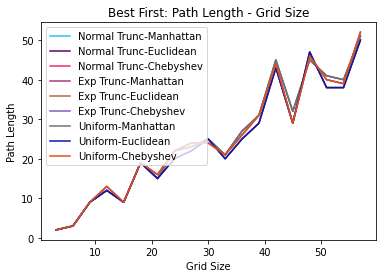

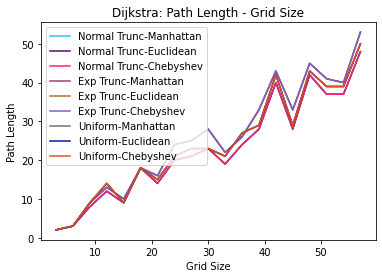

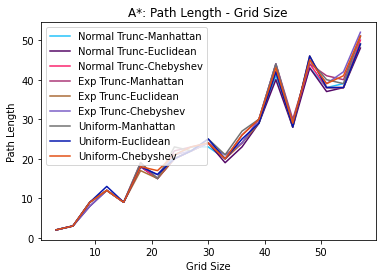

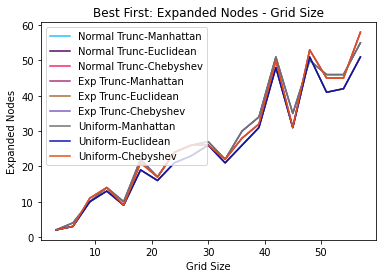

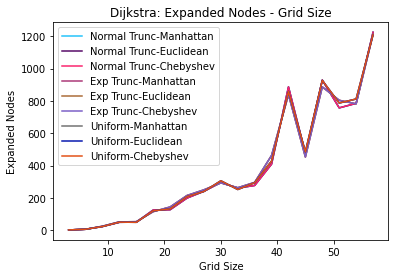

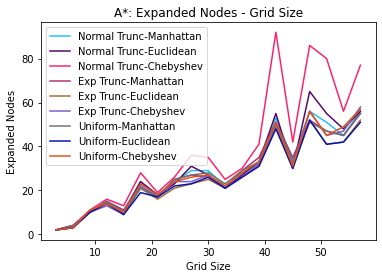

In [21]:
# ΜΕΡΟΣ 3, Γραφικές Παραστάσεις
import matplotlib.pyplot as plt

result=np.zeros((3,18,19), dtype=np.int32)
# Δομή Αποθήκευσης Αποτελεσμάτων
# 1η διάσταση: Για τους 3 Αλγορίθμους Best First, Dijkstra, A*
# 2η διάσταση: Για τους 9*2 Συνδυασμούς Κατανομής-Ευρυστικής στη κάθε γραφική παράσταση
# 3η διάσταση: Για τα 19 αποτελέσματα κάθε Συνδυασμού Κατανομής-Ευρυστικής σε μια γραφική παράσταση

x_axis=[]

for N in range (3,60,3): # Για μέγεθος λαβυρίνθου από 3 έως 60 με βήμα 3
    x_axis.append(N)
    temp_result=np.zeros((3,18), dtype=np.int32)
    
    for i in range (0,10): # Για 10 διαφορετικούς χάρτες
        # Φτιάχνεται ένα τυχαίος λαβύρινθος
        # Επιλέγουμε τυχαία την αρχή και το τέλος
        S=(random.randint(1,N-1),random.randint(1,N-1))
        F=(random.randint(1,N-1),random.randint(1,N-1))

        map = grid(N, S, F)
        map.make_random_path(S,F) # Δημιουργείται ένα μονοπάτι με βάση τον Αλγόριθμο του Μέρους 1
        
        # Για όλους τους διαφορετικούς αλγορίθμους: BF,Dijkstra,A*
        for k,algo in (0,(lambda x, y: y)),(1,(lambda x, y: x)),(2,(lambda x, y: x+y)):
            # Για όλες τις κατανομές
            for j,distr in (0,'norm_trunc'),(3,'exp_trunc'),(6,'uniform'):

                pf = pathfinder(S, F, map, algo , lambda x, y:manhattan_distance(x,y),distr)
                pf.find_path()
                temp_result[k,j]=len(pf.path)+temp_result[k,j] # BF,Μήκος Μονοπ,Norm-Manh 
                temp_result[k,9+j]=pf.closed_length()+temp_result[k,9+j] # BF,Exp Nodes,Norm-Manh     

                pf = pathfinder(S, F, map, algo , lambda x, y:euclidean_distance(x,y),distr)
                pf.find_path()
                temp_result[k,1+j]=len(pf.path)+temp_result[k,1+j] # BF,Μήκος Μονοπ,Norm-Eucl 
                temp_result[k,10+j]=pf.closed_length()+temp_result[k,10+j] # BF,Exp Nodes,Norm-Eucl      

                pf = pathfinder(S, F, map, algo , lambda x, y:chebyshev_distance(x,y),distr)
                pf.find_path()
                temp_result[k,2+j]=len(pf.path)+temp_result[k,2+j] # BF,Μήκος Μονοπ,Norm-Che 
                temp_result[k,11+j]=pf.closed_length()+temp_result[k,11+j] # BF,Exp Nodes,Norm-Che
                
    # Βρίσκω το Μέσο Όρο των τιμών που προέκυψαν από τους 10 διαφορετικούς λαβυρίνθους
    temp_result=temp_result/10
    for j in range(0,3):
        for k in range(0,18):
            result[j,k,int(N/3-1)]=temp_result[j,k] # Αποθήκευση αποτελεσμάτων για τη τρε΄χουσα τιμή του Ν
                                                    # στο τελικό πίνακα result
    
for i,title in (0,'Best First: Path Length - Grid Size'),(1,'Dijkstra: Path Length - Grid Size'),(2,'A*: Path Length - Grid Size'):      
    plt.plot(x_axis,result[i,0],label="Normal Trunc-Manhattan",color = "#22C2FB")
    plt.plot(x_axis,result[i,1],label="Normal Trunc-Euclidean",color='#550867')
    plt.plot(x_axis,result[i,2],label="Normal Trunc-Chebyshev", color = "#FB226D")
    plt.plot(x_axis,result[i,3],label="Exp Trunc-Manhattan",color = "#ab3776")
    plt.plot(x_axis,result[i,4],label="Exp Trunc-Euclidean",color='#ab6b37')
    plt.plot(x_axis,result[i,5],label="Exp Trunc-Chebyshev", color = "#7B5EC6")
    plt.plot(x_axis,result[i,6],label="Uniform-Manhattan",color = "#717171")
    plt.plot(x_axis,result[i,7],label="Uniform-Euclidean",color='#0516af')
    plt.plot(x_axis,result[i,8],label="Uniform-Chebyshev", color = "#E35015")
    plt.ylabel('Path Length') 
    plt.xlabel('Grid Size') 
    plt.title(title) 
    plt.legend() 
    plt.show()  

for i,title in (0,'Best First: Expanded Nodes - Grid Size'),(1,'Dijkstra: Expanded Nodes - Grid Size'),(2,'A*: Expanded Nodes - Grid Size'):      
    plt.plot(x_axis,result[i,9],label="Normal Trunc-Manhattan",color = "#22C2FB")
    plt.plot(x_axis,result[i,10],label="Normal Trunc-Euclidean",color='#550867')
    plt.plot(x_axis,result[i,11],label="Normal Trunc-Chebyshev", color = "#FB226D")
    plt.plot(x_axis,result[i,12],label="Exp Trunc-Manhattan",color = "#ab3776")
    plt.plot(x_axis,result[i,13],label="Exp Trunc-Euclidean",color='#ab6b37')
    plt.plot(x_axis,result[i,14],label="Exp Trunc-Chebyshev", color = "#7B5EC6")
    plt.plot(x_axis,result[i,15],label="Uniform-Manhattan",color = "#717171")
    plt.plot(x_axis,result[i,16],label="Uniform-Euclidean",color='#0516af')
    plt.plot(x_axis,result[i,17],label="Uniform-Chebyshev", color = "#E35015")
    plt.ylabel('Expanded Nodes') 
    plt.xlabel('Grid Size') 
    plt.title(title) 
    plt.legend() 
    plt.show()  

# Γραφικές Παραστάσεις

Οι γραφικές που προέκυψαν όταν το κόστος μετάβασης παίρνει τιμές στο (0,1) φαίνονται για την εκτέλεση του παραπάνω κώδικα.


Οι γραφικές που προέκυψαν όταν το κόστος μετάβασης παίρνει τιμές στο (1,2) είναι:

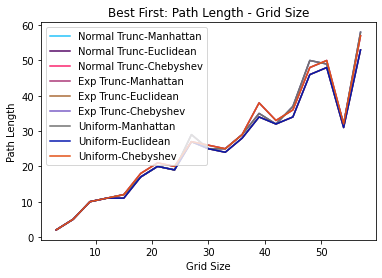
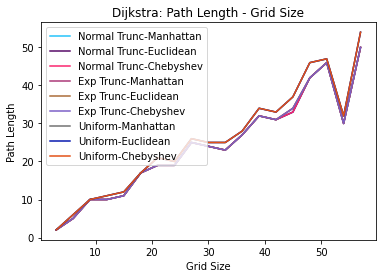
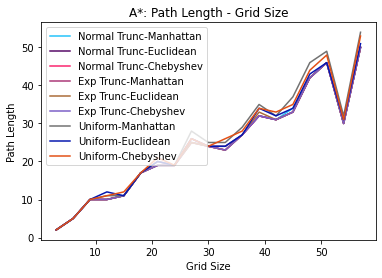
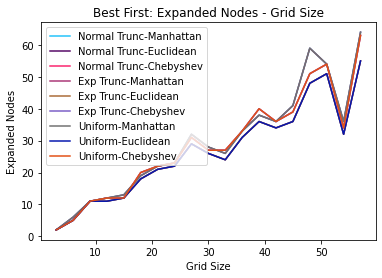
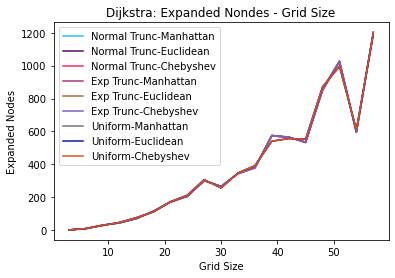
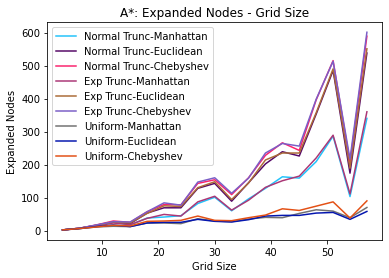


Οι γραφικές που προέκυψαν όταν το κόστος μετάβασης παίρνει τιμές στο [0,0.1) είναι:

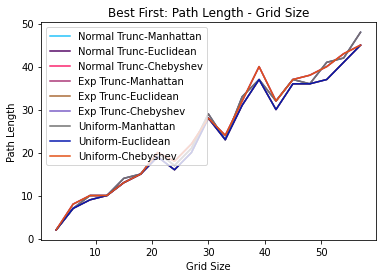
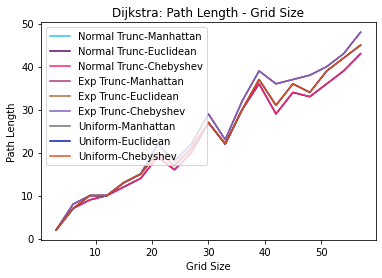
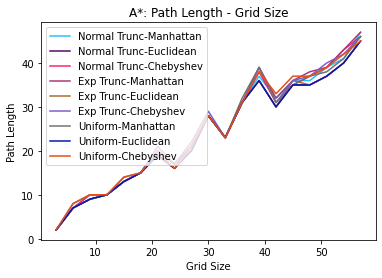
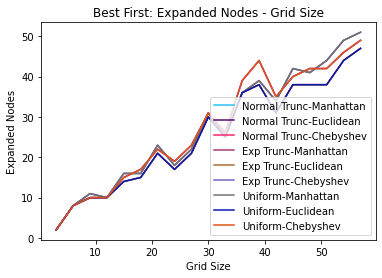
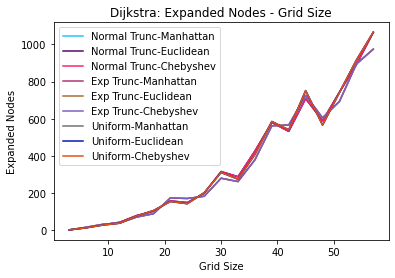
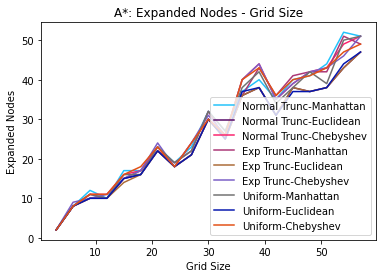


# Συγκρίσεις


Από τις γραφικές παραστάσεις παρατηρούμε ότι:
- #### Όσον αφορά το μήκος του μονοπατιού:

    ##### Συμπεράσματα που αφορούν όλους τους αλγορίθμους
     - Όσο αυξάνεται η διάσταση του πίνακα Ν, αυξάνεται προφανώς και το μήκος του μονοπατιού για κάθε αλγόριθμο. 
     - Οι αλγόριθμοι A* και Dijkstra βρίσκουν σε κάθε περίπτωση το ίδιο μήκος μονοπατιού, αφού βρίσκουν πάντα το βέλτιστο.
     - Ο αλγόριθμος Best First βρίσκει περίπου ίδιο μήκος μονοπατιού με τους υπόλοιπους αλγόριθμους για μικρούς χάρτες (δηλαδή μικρά Ν), αλλά όσο το Ν αυξάνεται, αυξάνεται και η διαφορά του με τη βέλτιστη λύση που προτείνουν οι υπόλοιποι αλγόριθμοι. Αυτό γίνεται  γιατί ο Best First δεν ψάχνει το βέλτιστο μονοπάτι,  αλλα ενδιαφέρεται κάθε φορά να μετακινηθεί προς τον κόμβο με την ελάχιστη ευριστική τιμή, έως ότου φτάσει στον κόμβο-στόχο. Αυτό άλλωστε φαίνεται και απο το ότι για τις ίδιες τιμές μεγέθους του grid (για μεγάλα Ν)  το  μήκος του μονοπατιού είναι μεγαλύτερο.
 
     
   ##### Συμπεράσματα που αφορούν κάθε αλγορίθμο ξεχωριστά 
     -Οσον αφορά τον  Best First για (0,1) χειρότερη ευριστική φαίνεται να  είναι  Chebyshev, ενώ καλύτερη είναι η Euclidean. Τα ίδια αποτελέσματα προκύπτουν και για (1,2) και [0,0.1).
     
     -Οσον αφορά τον Dijkstra για (0,1), λαμβάνεται υπόψην μόνο το κόστος μετάβασης απο τον ένα κόμβο στον άλλον.  Καλύτερη συμπεριφορά έχει η Normal Truncated, επόμενη  η Uniform  και χειρότερη η  Exponential Truncated. Αντίστοιχα αποτελέσματα εμφανίζονται και για [0,0.1). Αυτό είναι λογικό καθώς στη normal το κόστος μετάβασης σε κάθε κόμβο είναι σχετικά σταθερό κοντά στο 0.5 ή το 0.05 αντίστοιχα. Για κατανομή (1,2) η exponential έχει καλύτερη συμπεριφορά γιατί το κόστος μετάβασης προσεγγίζει το 1, δηλαδή αντιστοιχεί στη περίπτωση σταθερού κόστους μετάβασης.
     
     -Όσον αφορά τον  A* χειρότερη απόδοση έχει η Chebyshev με Exponential και καλύτερη Normal-Euclidean. Tα αποτελέσματα βέβαια επηρεάζονται από πολλούς παράγοντες, όπως η δομή του χάρτη, ή ο τρόπος κατασκευής του λαβυρίνθου, αλλά αυτές οι γραφικές μας δίνουν μια καλή ματιά. Παρόμοια συμπεράσματα ισχύουν για (1,2) με μία καλύτερη συμπεριφορά για την exponential για το λόγο που αναφέραμε πρίν. Για [0,0.1) προκύπτουν παρόμοια αποτελέσματα.
      Στη περίπτωση του κόστους (1,2) η επιλογή ευριστικής συνάρτησης παίζει λιγότερο σημαντικό ρόλο, αφού στην συνάρτηση  𝑓(𝑛)  την οποία χρησιμοποιεί ο  𝐴∗ θα έχει μεγαλύτερη επίδραση το βάρος μετακίνησης μεταξύ των κόμβων καθώς παίρνει μεγαλύτερες τιμές. Αντίστοιχα για τη περίπτωση [0,0.1) το συνολικό κόστος μετακίνησης έχει μικρότερη επίδραση λόγω μικρότερων τιμών.
     

 - #### Όσον αφορά τους επεκτεταμένους κόμβους (expanded nodes) του χάρτη:

    ##### Συμπεράσματα που αφορούν όλους τους αλγορίθμους

  - Όσο αυξάνεται η διάσταση του πίνακα Ν, εύλογο είναι να αυξάνεται  και το πλήθος των επεκτεταμένων κόμβων για κάθε αλγόριθμο.
  - Ο αλγόριθμος Best First επεκτείνει πάντα στους λιγότερους κόμβους από όλους τους αλγορίθμους. Ως προς το μέγεθος του πίνακα, καθώς αυτό αυξάνεται, ο Best First συνεχίζει να επεκτείνεται στους λιγότερους κόμβους, και μάλιστα η διαφορά του από τους υπόλοιπους φαίνεται να μεγαλώνει.Αυτό συμβαίνει διότι ο *Best First* λειτουργεί με βάση την επιλογή του καλύτερου επόμενου κόμβου, με κριτήριο την ευριστική συνάρτηση, μέχρι να καταλήξει στο στόχο του και όχι απαραίτητα την εύρεση ελάχιστου μήκους μονοπατιού.
    -Ο αλγόριθμος Dijkstra επεκτείνεται σε πολύ περισσότερους κόμβους από τους άλλους αλγορίθμους και φαίνεται να είναι ο χειρότερος από τους τρεις ως προς αυτό το κριτήριο. Αυτό είναι λογικό καθώς ενδιαφέρεται να βρει το βέλτιστο μονοπάτι βασιζόμενος μόνο στην συνάρτηση πραγματικού κόστους g(n)  και εξερευνά όλες τις πιθανές διαδρομές μέχρι να φτάσει στο στόχο,  άρα και αναγκαστικά επεκτείνεται σε περισσότερους κόμβους.
    
   - Ο αλγόριθμος Α* επεκτείνεται σε περισσότερους κόμβους από ότι ο *Best First*, αλλά σε σαφώς λιγότερους  από τον *Dijkstra*, πλησιάζοντας βέβαια περισσότερο στα αποτελέσματα του δεύτερου. Ο Α* έχει ως στόχο να βρει το μονοπάτι με το ελάχιστο μήκος βασιζόμενος στο άθροισμα ευριστικής συνάρτησης απόστασης και συνάρτησης πραγματικού κόστους, γι'αυτο και επεκτείνεται σε αρκετούς κόμβους. 
    
    
   ##### Συμπεράσματα που αφορούν όλους τους αλγορίθμους
     
     -Οσον αφορά τον  Best First η χειρότερη ευριστική φαίνεται να  είναι  Chebysev της οποίας τα αποτελέσματα είναι πολύ κοντά με τη Manhattan ενώ η καλύτερη είναι η Euclidean. Ομοίως για (1,2) και [0,0.1) 
     
     -Οσον αφορά τον Dijkstra, βλέπουμε ότι όλες έχουν σχεδόν παραπλήσια αποτελέσματα. Για (1,2) και [0,0.1) βλέπουμε οτι εμφανίζεται παρόμοια συμπεριφορά.
    
    -Όσον αφορά τον  A* όπως φάινεται απο την γραφική χειρότερη απόδοση έχει η Chebyshev με Uniform και καλύτερη η Exponential-Euclidean και γενικότερα οι Exponential. Για (1,2) και [0,0.1) καλύτερη συμπεριφορά έχουν οι Uniform, με την Euclidean να ξεχωρίζει και χειρότερη την Exponential Chebyshev .


Τα αποτελέσματα του  Α* προφανώς διαφέρουν ανάλογα με τη δομή του χάρτη, το πλήθος των εμποδίων, το τρόπο κατασκευής του λαβυρίνθου, το σημείο έναρξης και το σημείο τερματισμού που λαμβάνονται τυχαία για όλους τους λαβυρίνθους. Γενικά ο Α* συνοδεύεται και από έναν σχετικά μικρό χρόνο εύρεσης της λύσης σε σχέση με τους άλλους δύο αλγορίθμους (κυρίως με τον Dijkstra) , πράγμα που φαίνεται και από το Visualization καθώς είναι πιο γρήγορος.

Ανάλογα λοιπόν με το κριτήριο σύγκρισης των αλγορίθμων, η επιλογή του κατάλληλου αλγορίθμου εξαρτάται από πολλές παραμέτρους. Συγκεκριμένα αν μας ενδιαφέρει το μικρότερο μήκος μονοπατιού, ο Dijkstra και ο Α*  είναι οι καλύτερες επιλογές, αν θέλουμε να έχουμε ελάχιστους επεκτεταμένους κόμβους για την εύρεση ενός μονοπατιού, ο Best First δίνει τα καλύτερα αποτελέσματα, ενώ ως προς το χρόνο ο Α* δίνει καλύτερο αποτέλεσμα από τον Dijkstra. Τα αποτελέσματα αυτά προφανώς εξαρτώνται και από την επιλογή της ευριστικής.


